Упражнение 6.1

Было проведено сравнение производительности двух функций для анализа сигналов: analyze1 и analyze2. Построенный логарифмический график времени выполнения показал, что функция analyze2 в среднем работает в два раза быстрее при обработке больших объёмов данных.

117 μs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
396 μs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
2.46 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
58.9 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
288 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
1.68 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
2.15 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
73.8 μs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
241 μs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
962 μs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
4.38 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
18.7 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
83.1 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
325 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


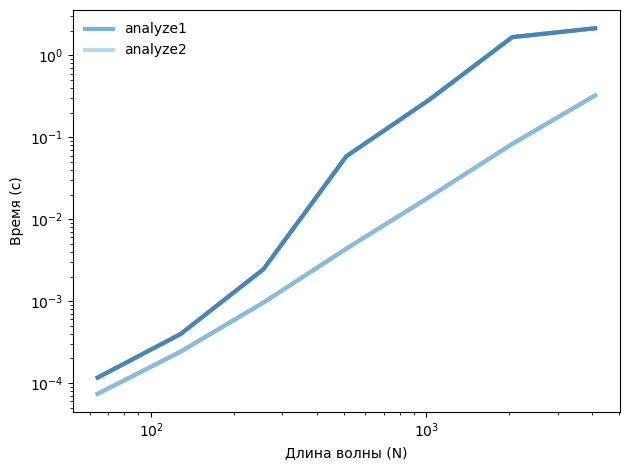

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

import thinkplot
import numpy as np

from thinkdsp import decorate, UncorrelatedGaussianNoise, read_wave, Spectrogram, plt
from scipy.stats import linregress

PI2 = np.pi * 2

signal = UncorrelatedGaussianNoise()
noise = signal.make_wave(duration=1.0, framerate=16384)
noise.ys.shape
ns = 2 ** np.arange(6, 13)
ns
def plots(p):    
    thinkplot.plot(ns, p)
    thinkplot.config(xscale='log', yscale='log', legend=False)
    
    x = np.log(ns)
    y = np.log(p)
    t = linregress(x,y)
    slope = t[0]

    return slope
def analyze1(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.linalg.solve(M, ys)
    return amps
results = []
for N in ns:
    ts = (0.5 + np.arange(N)) / N
    freqs = (0.5 + np.arange(N)) / 2
    ys = noise.ys[:N]
    result = %timeit -r1 -o analyze1(ys, freqs, ts)
    results.append(result)
    
p = [result.best for result in results]
plots(p)
def analyze2(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.dot(M, ys) / 2
    return amps
results = []
for N in ns:
    ts = (0.5 + np.arange(N)) / N
    freqs = (0.5 + np.arange(N)) / 2
    ys = noise.ys[:N]
    result = %timeit -r1 -o analyze2(ys, freqs, ts)
    results.append(result)
    
p2 = [result.best for result in results]
plots(p2)
thinkplot.plot(ns, p, label='analyze1')
thinkplot.plot(ns, p2, label='analyze2')
decorate(xlabel='Длина волны (N)', ylabel='Время (с)')
wave = read_wave('1.1.wav')
wave.make_audio()

In [2]:
segment = wave.segment(start=0, duration=0.75)
segment.normalize()
segment.make_audio()

Упражнение 6.2

Был реализован алгоритм, использующий дискретное косинусное преобразование (ДКП) для сжатия аудиосигнала. В качестве исходных данных использовался музыкальный файл ‘1.1.wav’. Был обработан фрагмент длительностью в одну секунду, для которого был построен график ДКП. Затем к сигналу была применена функция сжатия. График преобразования после сжатия также был визуализирован. В ходе прослушивания было установлено, что при определённых пороговых значениях в сжатом сигнале появляется заметный шум.

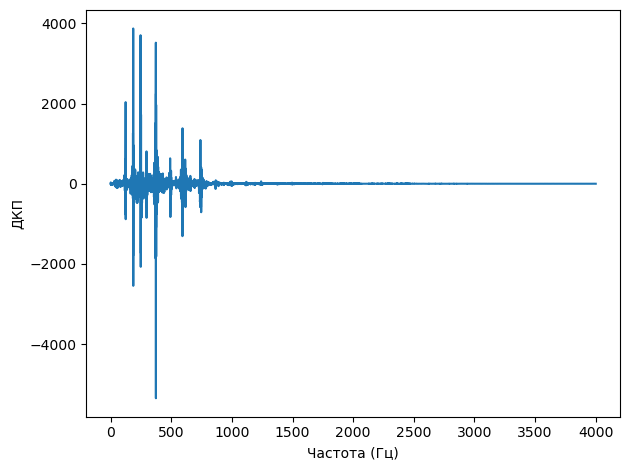

In [3]:
seg_dct = segment.make_dct()
seg_dct.plot(high=4000)
decorate(xlabel='Частота (Гц)', ylabel='ДКП')
plt.show()

In [4]:
def compress(dct, thresh=1):
    count = 0
    for i, amp in enumerate(dct.amps):
        if np.abs(amp) < thresh:
            dct.hs[i] = 0
            count += 1
            
    n = len(dct.amps)
    #print(count, n, 100 * count / n, sep='\t')

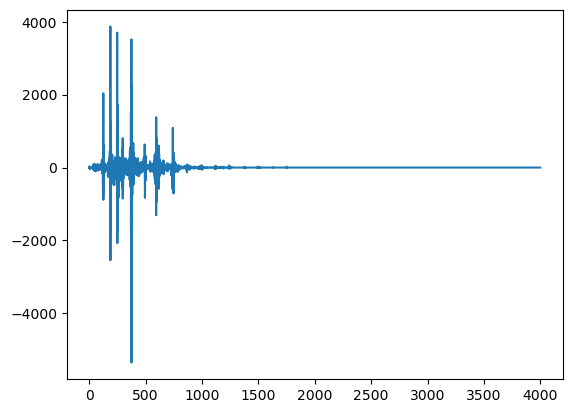

In [5]:
seg_dct = segment.make_dct()
compress(seg_dct, thresh=10)
seg_dct.plot(high=4000)
seg2 = seg_dct.make_wave()
seg2.make_audio()

In [6]:
def make_spectrogram(wave, seg_length):
    window = np.hamming(seg_length)
    i, j = 0, seg_length
    step = seg_length // 2
    spec_map = {}

    while j < len(wave.ys):
        segment = wave.slice(i, j)
        segment.window(window)

        t = (segment.start + segment.end) / 2
        spec_map[t] = segment.make_dct()

        i += step
        j += step

    return Spectrogram(spec_map, seg_length)
spectro = make_spectrogram(wave, seg_length=2048)
for t, dct in sorted(spectro.spec_map.items()):
    compress(dct, thresh=0.3)
wave2 = spectro.make_wave()
wave2.make_audio()

In [7]:
def plot_angle(spectrum, thresh=1):
    angles = spectrum.angles
    angles[spectrum.amps < thresh] = np.nan
    thinkplot.plot(spectrum.fs, angles, 'x')
    decorate(xlabel='Частота (Гц)', ylabel='Фаза')
def plot_three(spectrum, thresh=1):
    thinkplot.preplot(cols=3)
    spectrum.plot()
    thinkplot.subplot(2)
    plot_angle(spectrum, thresh=thresh)
    thinkplot.subplot(3)
    wave = spectrum.make_wave()
    wave.segment(duration=0.01).plot()
    wave.apodize()
    display(wave.make_audio())

In [8]:
wave = read_wave('120994__thirsk__120-oboe.wav')
wave.make_audio()

Упражнение 6.3

Было исследовано влияние фазового сдвига на восприятие звука на примере аудиофрагмента гобоя (длительность 0.5 секунды, начало на 1.5 секунде). Были построены графики для исходного сигнала, сигнала с нулевой фазой и сигнала со случайным фазовым сдвигом. Эксперимент показал, что изменение фазы не оказало существенного влияния на воспринимаемую высоту звука.

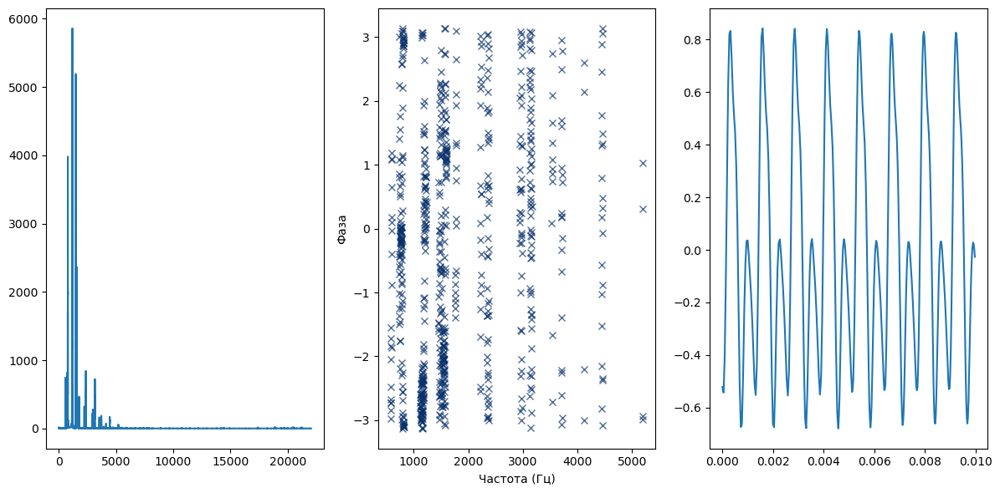

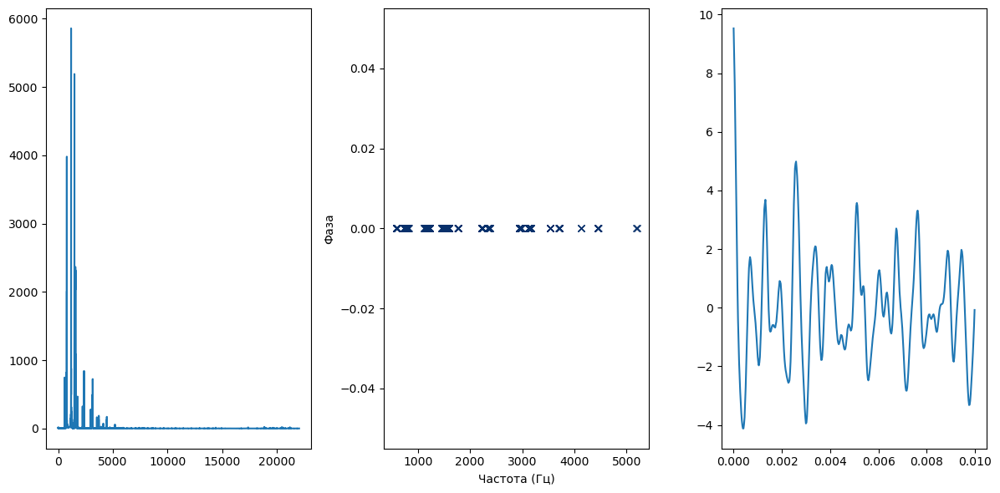

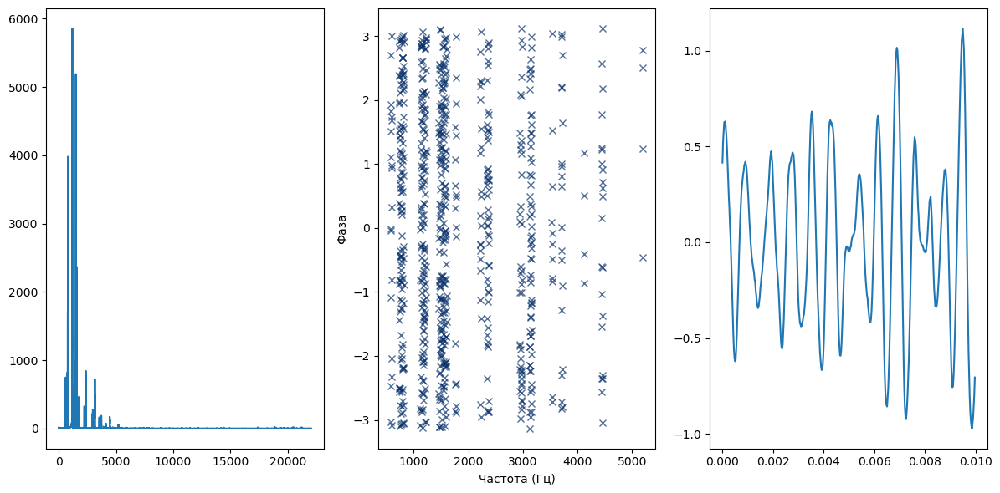

In [9]:
segment = wave.segment(start=0.5, duration=1.5)

spectrum = segment.make_spectrum()
plot_three(spectrum, thresh=50)
plt.show()
def zero_angle(spectrum):
    res = spectrum.copy()
    res.hs = res.amps
    return res
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)
plt.show()
def rotate_angle(spectrum, offset):
    res = spectrum.copy()
    res.hs *= np.exp(1j * offset)
    return res
def random_angle(spectrum):
    res = spectrum.copy()
    angles = np.random.uniform(0, PI2, len(spectrum))
    res.hs *= np.exp(1j * angles)
    return res
spectrum3 = random_angle(spectrum)
plot_three(spectrum3, thresh=50)
plt.show()

Вывод (Лабораторная работа №6):


В ходе лабораторной работы были освоены методы анализа звуковых сигналов с использованием дискретного косинусного преобразования (ДКП). Была оценена производительность различных алгоритмов ДКП. Реализован метод сжатия аудиосигнала на основе ДКП и исследовано его влияние на качество звука. Также было изучено влияние фазовой модуляции на восприятие высоты звука, которое оказалось незначительным для данного примера.